# Working with Vertically Pointing Radar Data Using `PyART`, `Xarray`, and `hvPlot`
This notebook will walk through how to utilize existing packages in the Python ecosystem (`PyART`, `Xarray`, and `hvPlot`) to visualize data from a vertically pointing Ka-band radar

## Data Overview

Before starting up this notebook, make sure to download your data from the [ARM data portal](https://adc.arm.gov/discovery/#/results/datastream::guckazrcfrgeM1.a1), using this link!

We are using data from a snow storm on 14 March 2022.


### Ka-band ARM zenith radar (KAZR) Instrument

An image of the KAZR radar collecting the data is shown below:

![KAZR radar](https://www.arm.gov/uploads/kazrcomp.jpg)

From the official [ARM KAZR Documentation](https://armweb0-stg.ornl.gov/capabilities/instruments/kazr),
"The Ka-band ARM zenith radar (KAZR) remotely probes the extent and composition of clouds at millimeter wavelengths. The KAZR is a zenith-pointing Doppler radar that operates at a frequency of approximately 35 GHz. The main purpose of this radar is to determine the first three Doppler moments (reflectivity, vertical velocity, and spectral width) at a range resolution of approximately 30 meters from near-ground to nearly 20 km in altitude."



## Imports
Before running through this notebook, you will need to install :
- [`matplotlib`](https://matplotlib.org/stable/users/getting_started/)
- [`pyart`](https://arm-doe.github.io/pyart/index.html#install)
- [`hvplot`](https://hvplot.holoviz.org/#installation)
- [`holoviews`](https://holoviews.org/#installation)

<img src='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAEAAAABACAYAAACqaXHeAAAABHNCSVQICAgIfAhkiAAAAAlwSFlz
AAAB+wAAAfsBxc2miwAAABl0RVh0U29mdHdhcmUAd3d3Lmlua3NjYXBlLm9yZ5vuPBoAAA6zSURB
VHic7ZtpeFRVmsf/5966taWqUlUJ2UioBBJiIBAwCZtog9IOgjqACsogKtqirT2ttt069nQ/zDzt
tI4+CrJIREFaFgWhBXpUNhHZQoKBkIUASchWla1S+3ar7r1nPkDaCAnZKoQP/D7mnPOe9/xy76n3
nFSAW9ziFoPFNED2LLK5wcyBDObkb8ZkxuaoSYlI6ZcOKq1eWFdedqNzGHQBk9RMEwFAASkk0Xw3
ETacDNi2vtvc7L0ROdw0AjoSotQVkKSvHQz/wRO1lScGModBFbDMaNRN1A4tUBCS3lk7BWhQkgpD
lG4852/+7DWr1R3uHAZVQDsbh6ZPN7CyxUrCzJMRouusj0ipRwD2uKm0Zn5d2dFwzX1TCGhnmdGo
G62Nna+isiUqhkzuKrkQaJlPEv5mFl2fvGg2t/VnzkEV8F5ioioOEWkLG86fvbpthynjdhXYZziQ
x1hC9J2NFyi8vCTt91Fh04KGip0AaG9zuCk2wQCVyoNU3Hjezee9bq92duzzTmxsRJoy+jEZZZYo
GTKJ6SJngdJqAfRzpze0+jHreUtPc7gpBLQnIYK6BYp/uGhw9YK688eu7v95ysgshcg9qSLMo3JC
4jqLKQFBgdKDPoQ+Pltb8dUyQLpeDjeVgI6EgLIQFT5tEl3rn2losHVsexbZ3EyT9wE1uGdkIPcy
BGxn8QUq1QrA5nqW5i2tLqvrrM9NK6AdkVIvL9E9bZL/oyfMVd/jqvc8LylzRBKDJSzIExwhQzuL
QYGQj4rHfFTc8mUdu3E7yoLtbTe9gI4EqVgVkug2i5+uXGo919ixbRog+3fTbQ8qJe4ZOYNfMoTI
OoshUNosgO60AisX15aeI2PSIp5KiFLI9ubb1vV3Qb2ltwLakUCDAkWX7/nHKRmmGIl9VgYsUhJm
2NXjKYADtM1ygne9QQDIXlk49FBstMKx66D1v4+XuQr7vqTe0VcBHQlRWiOCbmmSYe2SqtL6q5rJ
zsTb7lKx3FKOYC4DoqyS/B5bvLPxvD9Qtf6saxYLQGJErmDOdOMr/zo96km1nElr8bmPOBwI9COv
HnFPRIwmkSOv9kcAS4heRsidOkpeWBgZM+UBrTFAXNYL5Vf2ii9c1trNzpYdaoVil3WIc+wdk+gQ
noie3ecCcxt9ITcLAPWt/laGEO/9U6PmzZkenTtsSMQ8uYywJVW+grCstAvCIaAdArAsIWkRDDs/
KzLm2YcjY1Lv0UdW73HabE9n6V66cxSzfEmuJssTpKGVp+0vHq73FwL46eOjpMpbRAnNmJFrGJNu
Ukf9Yrz+3rghiumCKNXXWPhLYcjxGsIpoCMsIRoFITkW8AuyM8jC1+/QLx4bozCEJIq38+1rtpR6
V/yzb8eBlRb3fo5l783N0CWolAzJHaVNzkrTzlEp2bQ2q3TC5gn6wpnoQAmwSiGh2GitnTmVMc5O
UyfKWUKCIsU7+fZDKwqdT6DDpvkzAX4/+AMFjk0tDp5GRXLpQ2MUmhgDp5gxQT8+Y7hyPsMi8uxF
71H0oebujHALECjFKaW9Lm68n18wXp2kVzIcABytD5iXFzg+WVXkegpAsOOYziqo0OkK76GyquC3
ltZAzMhhqlSNmmWTE5T6e3IN05ITFLM4GdN0vtZ3ob8Jh1NAKXFbm5PtLU/eqTSlGjkNAJjdgn/N
aedXa0tdi7+t9G0FIF49rtMSEgAs1kDLkTPO7ebm4IUWeyh1bKomXqlgMG6kJmHcSM0clYLJ8XtR
1GTnbV3F6I5wCGikAb402npp1h1s7LQUZZSMIfALFOuL3UUrfnS8+rez7v9qcold5tilgHbO1fjK
9ubb17u9oshxzMiUBKXWqJNxd+fqb0tLVs4lILFnK71H0Ind7uiPgACVcFJlrb0tV6DzxqqTIhUM
CwDf1/rrVhTa33/3pGPxJYdQ2l2cbgVcQSosdx8uqnDtbGjh9SlDVSMNWhlnilfqZk42Th2ZpLpf
xrHec5e815zrr0dfBZSwzkZfqsv+1FS1KUknUwPARVvItfKUY+cn57yP7qv07UE3p8B2uhUwLk09
e0SCOrK+hbdYHYLjRIl71wWzv9jpEoeOHhGRrJAzyEyNiJuUqX0g2sBN5kGK6y2Blp5M3lsB9Qh4
y2Ja6x6+i0ucmKgwMATwhSjdUu49tKrQ/pvN5d53ml2CGwCmJipmKjgmyuaXzNeL2a0AkQ01Th5j
2DktO3Jyk8f9vcOBQHV94OK+fPumJmvQHxJoWkaKWq9Vs+yUsbq0zGT1I4RgeH2b5wef7+c7bl8F
eKgoHVVZa8ZPEORzR6sT1BzDUAD/d9F78e2Tzv99v8D+fLVTqAKAsbGamKey1Mt9Ann4eH3gTXTz
idWtAJ8PQWOk7NzSeQn/OTHDuEikVF1R4z8BQCy+6D1aWRfY0tTGG2OM8rRoPaeIj5ZHzJxszElN
VM8K8JS5WOfv8mzRnQAKoEhmt8gyPM4lU9SmBK1MCQBnW4KONT86v1hZ1PbwSXPw4JWussVjtH9Y
NCoiL9UoH/6PSu8jFrfY2t36erQHXLIEakMi1SydmzB31h3GGXFDFNPaK8Rme9B79Ixrd0WN+1ij
NRQ/doRmuFLBkHSTOm5GruG+pFjFdAmorG4IXH1Qua6ASniclfFtDYt+oUjKipPrCQB7QBQ2lrgP
fFzm+9XWUtcqJ3/5vDLDpJ79XHZk3u8nGZ42qlj1+ydtbxysCezrydp6ugmipNJ7WBPB5tydY0jP
HaVNzs3QzeE4ZpTbI+ZbnSFPbVOw9vsfnVvqWnirPyCNGD08IlqtYkh2hjZ5dErEQzoNm+6ykyOt
Lt5/PQEuSRRKo22VkydK+vvS1XEKlhCJAnsqvcVvH7f/ZU2R67eXbMEGAMiIV5oWZWiWvz5Fv2xG
sjqNJQRvn3Rs2lji/lNP19VjAQDgD7FHhujZB9OGqYxRkZxixgRDVlqS6uEOFaJUVu0rPFzctrnF
JqijImVp8dEKVWyUXDk92zAuMZ6bFwpBU1HrOw6AdhQgUooChb0+ItMbWJitSo5Ws3IAOGEOtL53
0vHZih9sC4vtofZ7Qu6523V/fmGcds1TY3V36pUsBwAbSlxnVh2xLfAD/IAIMDf7XYIkNmXfpp2l
18rkAJAy9HKFaIr/qULkeQQKy9zf1JgDB2uaeFNGijo5QsUyacNUUTOnGO42xSnv4oOwpDi1zYkc
efUc3I5Gk6PhyTuVKaOGyLUAYPGIoY9Pu/atL/L92+4q9wbflRJ2Trpm/jPjdBtfnqB/dIThcl8A
KG7hbRuKnb8qsQsVvVlTrwQAQMUlf3kwJI24Z4JhPMtcfng5GcH49GsrxJpGvvHIaeem2ma+KSjQ
lIwUdYyCY8j4dE1KzijNnIP2llF2wcXNnsoapw9XxsgYAl6k+KzUXbi2yP3KR2ecf6z3BFsBICdW
nvnIaG3eHybqX7vbpEqUMT+9OL4Qpe8VON7dXuFd39v19FoAABRVePbGGuXTszO0P7tu6lghUonE
llRdrhArLvmKdh9u29jcFiRRkfLUxBiFNiqSU9icoZQHo5mYBI1MBgBH6wMNb+U7Pnw337H4gi1Y
ciWs+uks3Z9fztUvfzxTm9Ne8XXkvQLHNytOOZeiD4e0PgkAIAYCYknKUNUDSXEKzdWNpnil7r4p
xqkjTarZMtk/K8TQ6Qve78qqvXurGwIJqcOUKfUWHsm8KGvxSP68YudXq4pcj39X49uOK2X142O0
Tz5/u/7TVybqH0rSya6ZBwD21/gubbrgWdDgEOx9W
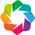

In [2]:
import matplotlib.pyplot as plt
import glob
import pyart
import pandas as pd
import hvplot.xarray
from bokeh.models.formatters import DatetimeTickFormatter
import xarray as xr
import holoviews as hv
import warnings

warnings.filterwarnings("ignore")
hv.extension('bokeh')

## Plot Using PyART
Let's first try plotting using the Python ARM Radar Toolkit (PyART)!

### Load in the data using `pyart`
We can use the `pyart.io.read()` function for this dataset!

In [3]:
radar = pyart.io.read('guckazrcfrgeM1.a1.20220314.000003.nc')

This returns a `radar` object, which is the primary data model in PyART

In [4]:
radar

If we wanted to take a look at what fields are available, we can print out `radar.fields`, formatting that as a list

In [5]:
list(radar.fields)

['linear_depolarization_ratio',
 'mean_doppler_velocity',
 'mean_doppler_velocity_crosspolar_v',
 'reflectivity',
 'reflectivity_crosspolar_v',
 'signal_to_noise_ratio_copolar_h',
 'signal_to_noise_ratio_crosspolar_v',
 'spectral_width',
 'spectral_width_crosspolar_v']

Let's take a look at `reflectivity` and `mean_doppler_velocity`

### Plot the Data in PyART
We will use the `RadarDisplay` as our mapping class, and the `plot_vpt`, which is made to work with verticall pointing radars (which is what KAZR is!)

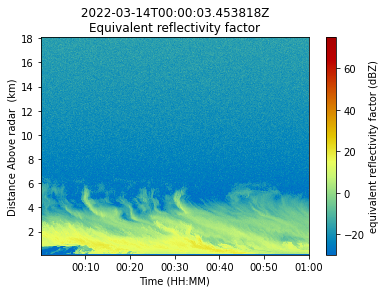

In [6]:
display = pyart.graph.RadarDisplay(radar)
display.plot_vpt('reflectivity', time_axis_flag=True, edges=False)

We can also take a look at the `mean_doppler_velocity`, which is the radial velocity (wind speed) away from the radar (from the ground in this case)

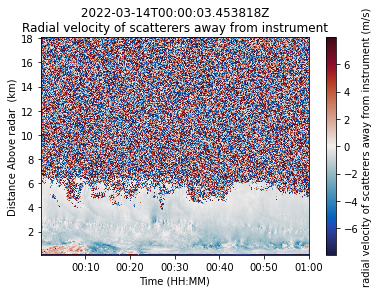

In [7]:
display = pyart.graph.RadarDisplay(radar)
display.plot_vpt('mean_doppler_velocity', time_axis_flag=True, edges=False, cmap='pyart_balance')

### Clean Up the Plots a Bit
We can zoom in a bit on the lower part of the atmosphere here (below 7 km) since there is a substantial amount of noise above that, and combine our plots into a single figure using `plt.subplot()`

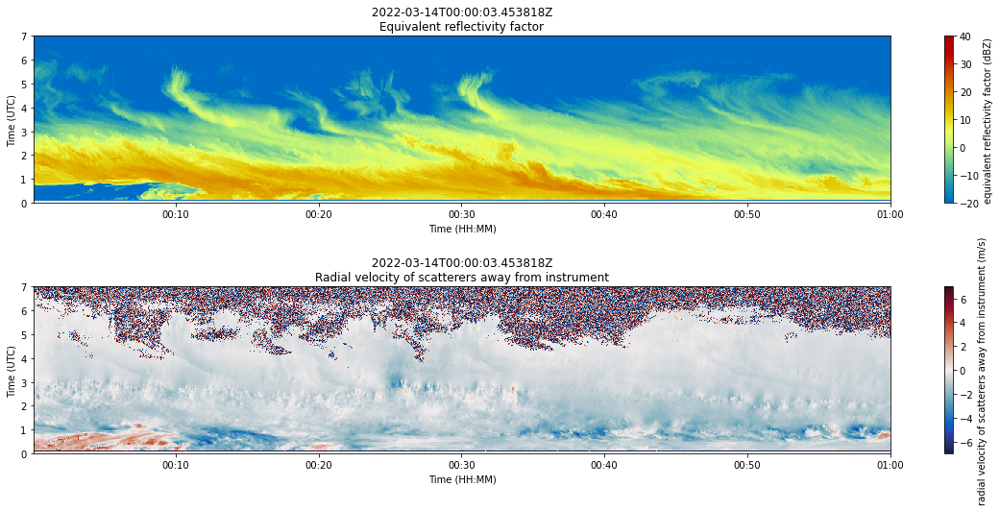

In [8]:
fig = plt.figure(figsize=(20,8))

display = pyart.graph.RadarDisplay(radar)

# Create an axis for reflectivity
ax1 = plt.subplot(211)

# Plot reflectivity
display.plot_vpt('reflectivity',
                 fig=fig,
                 ax=ax1,
                 vmin=-20,
                 vmax=40,
                 time_axis_flag=True,
                 edges=False)

# Limit the y-axis to 0 to 7 km
plt.ylim(0, 7)

# Label the y-axis
plt.ylabel('Time (UTC)')

# Create an axis for velocity
ax2 = plt.subplot(212)

# Plot doppler velocity
display.plot_vpt('mean_doppler_velocity',
                 fig=fig,
                 ax=ax2,
                 vmin=-7,
                 vmax=7,
                 time_axis_flag=True,
                 edges=False,
                 cmap='pyart_balance')

# Limit the y-axis to 0 to 7 km
plt.ylim(0, 7)

# Label the y-axis
plt.ylabel('Time (UTC)')

# Add some space in between the plots
plt.subplots_adjust(hspace=.5)

## Plot Up Our Analysis Using Xarray + hvPlot

Let's try another method of reading in and visualization... focusing on using `xarray` and `hvPlot`, which are key components of the Pangeo stack

### Read the Data Using `Xarray`
Xarray has a similar `.open()` function, titled `open_dataset`

In [9]:
ds = xr.open_dataset('guckazrcfrgeM1.a1.20220314.000003.nc')
ds

<xarray.Dataset>
Dimensions:                             (time: 1736, range: 600, frequency: 1,
                                         sweep: 1, r_calib: 1)
Coordinates:
  * time                                (time) datetime64[ns] 2022-03-14T00:0...
  * frequency                           (frequency) float32 3.489e+10
  * range                               (range) float32 100.7 ... 1.806e+04
    azimuth                             (time) float32 ...
    elevation                           (time) float32 ...
Dimensions without coordinates: sweep, r_calib
Data variables: (12/38)
    base_time                           datetime64[ns] ...
    time_offset                         (time) datetime64[ns] ...
    linear_depolarization_ratio         (time, range) float32 ...
    mean_doppler_velocity               (time, range) float32 ...
    mean_doppler_velocity_crosspolar_v  (time, range) float32 ...
    reflectivity                        (time, range) float32 ...
    ...                                  ...
    longitude                           float32 ...
    altitude                            float32 ...
    altitude_agl                        float32 ...
    lat                                 float32 ...
    lon                                 float32 ...
    alt                                 float32 ...
Attributes: (12/31)
    command_line:             kazrcfr_ingest -s guc -f M1
    Conventions:              ARM-1.3 CF/Radial-1.4 instrument_parameters rad...
    process_version:          ingest-kazrcfr-1.3-0.el7
    dod_version:              kazrcfrge-a1-1.1
    input_source:             /data/collection/guc/guckazrM1.00/KAZR_MOMENTS_...
    site_id:                  guc
    ...                       ...
    scan_mode:                vertically-pointing
    scan_name:                vpt
    software_version:         1.7.6 (Wed Mar 23 17:10:35 UTC 2016 leachman
    title:                    ARM KAZR Moments
    doi:                      10.5439/1498936
    history:                  created by user dsmgr on machine procnode2 at 2...

### Subset for Time, Reflectivity and Velocity
Xarray has some helpful subsetting tools - including `isel()` which is index-based selection. In this case, since we don't want to visualize the entire time period, we select the first 600 time steps

In [10]:
ds = ds.isel(time=range(600))

We are interested in looking at reflectivity and velocity here, and we can drop a couple of extra coordinates we don't need (`azimuth` and `elevation`) since we won't use them

In [11]:
ds = ds[['reflectivity', 'mean_doppler_velocity']].drop(['elevation', 'azimuth'])
ds

<xarray.Dataset>
Dimensions:                (time: 600, range: 600)
Coordinates:
  * time                   (time) datetime64[ns] 2022-03-14T00:00:00.453818 ....
  * range                  (range) float32 100.7 130.7 ... 1.803e+04 1.806e+04
Data variables:
    reflectivity           (time, range) float32 ...
    mean_doppler_velocity  (time, range) float32 ...
Attributes: (12/31)
    command_line:             kazrcfr_ingest -s guc -f M1
    Conventions:              ARM-1.3 CF/Radial-1.4 instrument_parameters rad...
    process_version:          ingest-kazrcfr-1.3-0.el7
    dod_version:              kazrcfrge-a1-1.1
    input_source:             /data/collection/guc/guckazrM1.00/KAZR_MOMENTS_...
    site_id:                  guc
    ...                       ...
    scan_mode:                vertically-pointing
    scan_name:                vpt
    software_version:         1.7.6 (Wed Mar 23 17:10:35 UTC 2016 leachman
    title:                    ARM KAZR Moments
    doi:                      10.5439/1498936
    history:                  created by user dsmgr on machine procnode2 at 2...

### Plot a Quick Plot using Xarray
We can use the `.plot()` with our dataset if we want to get a quick-look at the data

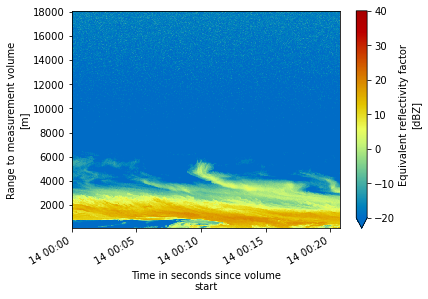

In [12]:
ds.reflectivity.plot(x='time',
                     cmap='pyart_HomeyerRainbow',
                     vmin=-20,
                     vmax=40)

This provided a similar view to our plot above - but what if we wanted to plot this interactively? We can use [`hvPlot`](https://hvplot.holoviz.org) which is a high-level interactive plotting library, meant to work with `xarray.Datasets` along with other popular components of the Python ecosystem.

### Extract Date Information for Labels
Before we jump into the plotting, let's define some helpful formatting tools.

First, we can parse the date from our dataset:

In [13]:
date = pd.to_datetime(ds.time.values[0]).strftime('%d %b %Y')
date

'14 Mar 2022'

For the interactive plot, we need to specify how our x-axis (`time`) labels are formatted

In [14]:
formatter = DatetimeTickFormatter(minutes="%H:%M UTC")

### Create our Holoviews Plots
We create two interactive plots, one for reflectivity and the other doppler velocity.

Included in each plotting call are additional parameters:
- `x` : which field to use as the x-axis
- `cmap` : which colormap to use
- `clim` : color bar limits (equivalent to vmin/vmax)
- `hover` : whether to plot an interactive data inspection tool
- `colorbar` : whether to include a colorbar with the plot
- `clabel` : colorbar label
- `title` : Plot title (works at the subplot level)
- `xformatter` : formatter for the x-axis, in this case, our time
- `xlabel` : label 

In [15]:
ref_plot = ds.reflectivity.hvplot.quadmesh(x='time',
                                           cmap='pyart_HomeyerRainbow',
                                           clim=(-20, 40),
                                           ylim=(0, 7000),
                                           hover=True,
                                           colorbar=True,
                                           clabel='Reflectivity (dBZ)',
                                           title=f'{ds.platform_id} \n{ds.location_description} \n{date}',
                                           xformatter = formatter,
                                           xlabel= 'Time (UTC)'
                                          ).opts(fontsize={'title': 10, 
                                                           'labels': 10,
                                                           'xticks': 10, 
                                                           'yticks': 10,
                                                          })

vel_plot = ds.mean_doppler_velocity.hvplot.quadmesh(x='time',
                                                    cmap='pyart_balance',
                                                    clim=(-7, 7),
                                                    ylim=(0, 7000),
                                                    clabel='Velocity (m/s)',
                                                    title=f'{ds.platform_id} \n{ds.location_description} \n{date}',
                                                    xformatter=formatter,
                                                    xlabel= 'Time (UTC)'
                                                   ).opts(fontsize={'title': 10, 
                                                                    'labels': 10,
                                                                    'xticks': 10, 
                                                                    'yticks': 10})

## View the Final Visualization
Now that we have prepared our plots, let's take a look at the output!

We can combine our plots by adding them `(plot1 + plot2)` together, specifying we desire a single column (`.cols(1)`).

In [16]:
(ref_plot + vel_plot).cols(1)

:Layout
   .QuadMesh.I  :QuadMesh   [time,range]   (reflectivity)
   .QuadMesh.II :QuadMesh   [time,range]   (mean_doppler_velocity)

### Try Using Rasterize
We would ideally use `rasterize=True` here to utilize [Datashader](https://datashader.org) to lazily visualize our data, viewing our data a coarse resolution intially, and accessing the higher resolution data when we zoom in on particular regions.

Unfortunately, run into the following bug when trying this on our data...

In [17]:
ref_plot_raster = ds.reflectivity.hvplot.quadmesh(x='time',
                                           cmap='pyart_HomeyerRainbow',
                                           clim=(-20, 40),
                                           ylim=(0, 7000),
                                           rasterize=True,
                                           hover=True,
                                           colorbar=True,
                                           clabel='Reflectivity (dBZ)',
                                           title=f'{ds.platform_id} \n{ds.location_description} \n{date}',
                                           xformatter = formatter,
                                           xlabel= 'Time (UTC)'
                                          ).opts(fontsize={'title': 10, 
                                                           'labels': 10,
                                                           'xticks': 10, 
                                                           'yticks': 10,
                                                          })

ref_plot_raster

Invoked as dynamic_operation(height=300, scale=1.0, width=700, x_range=(numpy.datetime64('2022-03-13T23:59:59.417014000'), numpy.datetime64('2022-03-14T00:20:43.579705000')), y_range=(0, 7000))
Invoked as dynamic_operation(height=300, scale=1.0, width=700, x_range=(numpy.datetime64('2022-03-13T23:59:59.417014000'), numpy.datetime64('2022-03-14T00:20:43.579705000')), y_range=(0, 7000))
Invoked as dynamic_operation(height=300, scale=1.0, width=700, x_range=(numpy.datetime64('2022-03-13T23:59:59.417014000'), numpy.datetime64('2022-03-14T00:20:43.579705000')), y_range=(0, 7000))
Invoked as dynamic_operation(height=300, scale=1.0, width=700, x_range=(numpy.datetime64('2022-03-13T23:59:59.417014000'), numpy.datetime64('2022-03-14T00:20:43.579705000')), y_range=(0, 7000))


Traceback (most recent call last):
  File "/Users/mgrover/opt/anaconda3/envs/pyart-dev/lib/python3.9/site-packages/holoviews/plotting/util.py", line 277, in get_plot_frame
    return map_obj[key]
  File "/Users/mgrover/opt/anaconda3/envs/pyart-dev/lib/python3.9/site-packages/holoviews/core/spaces.py", line 1344, in __getitem__
    val = self._execute_callback(*tuple_key)
  File "/Users/mgrover/opt/anaconda3/envs/pyart-dev/lib/python3.9/site-packages/holoviews/core/spaces.py", line 1111, in _execute_callback
    retval = self.callback(*args, **kwargs)
  File "/Users/mgrover/opt/anaconda3/envs/pyart-dev/lib/python3.9/site-packages/holoviews/core/spaces.py", line 708, in __call__
    ret = self.callable(*args, **kwargs)
  File "/Users/mgrover/opt/anaconda3/envs/pyart-dev/lib/python3.9/site-packages/holoviews/util/__init__.py", line 1043, in dynamic_operation
    key, obj = resolve(key, kwargs)
  File "/Users/mgrover/opt/anaconda3/envs/pyart-dev/lib/python3.9/site-packages/holoviews/util/_

:DynamicMap   []
   :Image   [time,range]   (reflectivity)

## Key Takeaways
As we saw in this post, we have a few different options to plot vertically pointed radar data, including
- PyART (`RadarDisplay`)
- Xarray (`Matplotlib`)
- hvPlot (`hvplot.Quadmesh`)

Each approach has its own pros/cons, but one thing is clear: it will be helpful to continue to push for `xarray` integration with the `pyart.Radar` object, so that interactive plots like the one shown at the end of this post will be easier to create and share!

We ran into issues using `rasterize` with the `hvPlot` example - which is a bug that will need to examined further, as adding a `rasterize` capability with these data will enable a more performant, and shareable workflow since the notebooks including the rendered visualizing will be **much** smaller than the current implementation.

Since we include all of the data points, the total size of the notebook is ~50 MB, which makes visualizing and sharing the rendered plot difficult.

If you are interested in additional plots from this case, check out our [SAIL Jupyterbook](https://mgrover1.github.io/SAILS-radar-analysis/project-overview.html), documenting Jupyter Notebooks related to radar data analysis from the Surface Atmosphere Integrated Field Laboratory (SAIL) campaign!